# Analysis of BC's Lower Mainland Housing and Venue Data

### Import libraries

In [2]:
import requests
import pandas as pd
from bs4 import BeautifulSoup
import numpy as np
import re
from geopy.geocoders import Nominatim
import folium
import matplotlib.pyplot as plt
from collections import Counter

In [2]:
#!pip install yellowbrick

You should consider upgrading via the 'c:\users\krishant\anaconda3\python.exe -m pip install --upgrade pip' command.


### Data Collection - Web Scraping

In [3]:
url = 'https://www.moneysense.ca/spend/real-estate/where-to-buy-real-estate-in-2020-greater-vancouver/'
html_data = requests.get(url) #Get html data

soup = BeautifulSoup(html_data.content, 'html.parser') #Create soup object
table = soup.find('table') #Retrieve the only table
tr = table.find_all('tr') #Information inside of tr tags

In [4]:
#This block of code parses the html data and appends area, neighborhood, housing price data and gets latitude and longitude 
#data from neighborhood and areas. It then appends everything to a dict and into a list then creates a data frame.
table_content = []
for row in tr:
    try:
        cell={}
        content = row.text.split('\n')
        cell['Area'] = content[2]
        cell['Neighborhood'] = content[4]
        cell['Area Average Price'] = content[5].split('$')[1]
        address = '{}, {}, BC'.format(cell['Neighborhood'], cell['Area'])
        geolocator = Nominatim(user_agent="van_explorer")
        location = geolocator.geocode(address)
        cell['Latitude'] = location.latitude
        cell['Longitude'] = location.longitude
        table_content.append(cell)
    except:
        pass
df = pd.DataFrame(table_content)

In [58]:
df = pd.DataFrame(table_content)

In [59]:
df.head() #View the df 

,Area,Neighborhood,Area Average Price,Latitude,Longitude
0,Burnaby,Brentwood Park,"1,526,503.00",49.275226,-122.992929
1,Coquitlam,Coquitlam West,"1,206,271.00",49.262768,-122.816954
2,Burnaby,Metrotown,"1,526,503.00",49.225852,-123.003894
3,Vancouver East,Mount Pleasant VE,"1,455,124.00",49.264048,-123.096249
4,North Surrey,Whalley,"983,842",49.196964,-122.864473


In [105]:
len(df['Area'].value_counts())

22

In [5]:
#Since data consists of areas not pertaining to the lower mainland of BC we only keep areas of interest by setting a radius
#centered about new westminster.
lat, lng = 49.1737, -122.7604
for latt, lngg in zip(df['Latitude'], df['Longitude']):
    if (np.abs(latt - lat) >0.3) or (np.abs(lngg - lng) > 0.55): #parameters found by testing different values
        i = df.index[df['Latitude'] == latt][0]
        df.drop(i, axis=0, inplace=True)

In [6]:
van_df = df
van_df['Area Average Price']=van_df['Area Average Price'].str.replace(',', '').astype(float) #Remove commas
van_df = van_df[van_df['Neighborhood'] != 'Abbotsford East'] #Abbotsford East and West have exactly the same venues

In [7]:
van_df.head()

,Area,Neighborhood,Area Average Price,Latitude,Longitude
0,Burnaby,Brentwood Park,1526503.0,49.275226,-122.992929
1,Coquitlam,Coquitlam West,1206271.0,49.262685,-122.816971
2,Burnaby,Metrotown,1526503.0,49.225852,-123.003894
3,Vancouver East,Mount Pleasant VE,1455124.0,49.264048,-123.096249
4,North Surrey,Whalley,983842.0,49.196964,-122.864473


In [54]:
van_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 271 entries, 0 to 322
Data columns (total 5 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Area                271 non-null    object 
 1   Neighborhood        271 non-null    object 
 2   Area Average Price  271 non-null    float64
 3   Latitude            271 non-null    float64
 4   Longitude           271 non-null    float64
dtypes: float64(3), object(2)
memory usage: 12.7+ KB


### Explore Data

In [45]:
# create map of lower mainland BC using latitude and longitude values
latitude, longitude = 49.1737, -122.7604 #Set the center
map_van = folium.Map(location=[latitude, longitude], zoom_start=10)

# add markers to map
for lat, lng, Area, hood in zip(
    van_df['Latitude'], van_df['Longitude'], 
    van_df['Area'], van_df['Neighborhood']):
    label = '{}, {}'.format(hood, Area)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_van)  
map_van.save(outfile= "map_van.html")    
map_van

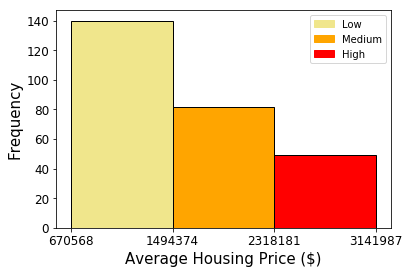

In [15]:
#Create histogram of housing price data and set color scheme
from matplotlib.patches import Rectangle
fig, ax = plt.subplots()
N, bins, patches =ax.hist(van_df['Area Average Price'], bins=3, edgecolor='black', linewidth=1)

#Create color scheme
for i in range(0,1):
    patches[i].set_facecolor('khaki')
for i in range(1,2):    
    patches[i].set_facecolor('orange')
for i in range(2, len(patches)):
    patches[i].set_facecolor('red')

handles = [Rectangle((0,0),1,1,color=c) for c in ['khaki','orange', 'red']]
labels= ["Low","Medium", "High"]
plt.legend(handles, labels)

ax.set_xticks(np.linspace(max(van_df['Area Average Price']), min(van_df['Area Average Price']),4))
ax.set_xlabel('Average Housing Price ($)', fontsize=15)
ax.set_ylabel('Frequency', fontsize=15)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
#plt.grid()
plt.show()

#### Create chorpleth map of housing price data

In [73]:
# create a numpy array of length 4 and has linear spacing from histogram analysis
threshold_scale = np.array([670000,1500000, 2315000, 3150000])
threshold_scale = threshold_scale.tolist() # change the numpy array to a list
threshold_scale[-1] = threshold_scale[-1] + 1 # make sure that the last value of the list is greater than the maximum immigration

can_geo = r'ABMS_MUNICIPALITIES_SP.geojson'


# let Folium determine the scale.
world_map = folium.Map(location=[49.2057, -122.9110], zoom_start=10)
world_map.choropleth(
    geo_data=can_geo,
    data=van_df,
    columns=['Area', 'Area Average Price'],
    key_on='feature.properties.ADMIN_AREA_ABBREVIATION',
    threshold_scale=threshold_scale,
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Average Housing Price ($)',
    reset=True
)
world_map.save(outfile= "world_map.html")
world_map


### Get nearby venues using foursquare api

In [20]:
CLIENT_ID = 'W1K3B3EXHOUCBDHAI5DIIXAP5Y0OCHFHMXGLVAXNZOFX4YCS' # your Foursquare ID
CLIENT_SECRET = '3KZ5JW1MQZWV531ZKJOGWULIWA1SOZXL2GH1HHL1M0RXZFQX' # your Foursquare Secret
ACCESS_TOKEN = 'YYCIEGWGT4TM1AGLAVMAJ2WZUKQDVEWGCFKJVRVF0LYKSPGF' # your FourSquare Access Token
VERSION = '20180605'
LIMIT = 100
print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: W1K3B3EXHOUCBDHAI5DIIXAP5Y0OCHFHMXGLVAXNZOFX4YCS
CLIENT_SECRET:3KZ5JW1MQZWV531ZKJOGWULIWA1SOZXL2GH1HHL1M0RXZFQX


In [21]:
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        #print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [22]:
#Get all the venue data and store it in df
BC_venues = getNearbyVenues(names=van_df['Neighborhood'],
                                   latitudes=van_df['Latitude'],
                                   longitudes=van_df['Longitude']
                                  )

In [23]:
BC_venues.shape

(3453, 7)

In [24]:
BC_venues.groupby('Neighborhood').count()

,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighborhood,,,,,,
Abbotsford West,1,1,1,1,1,1
Aberdeen,3,3,3,3,3,3
Albion,2,2,2,2,2,2
Aldergrove Langley,14,14,14,14,14,14
Ambleside,36,36,36,36,36,36
...,...,...,...,...,...,...
Whonnock,2,2,2,2,2,2
Whytecliff,3,3,3,3,3,3
Willingdon Heights,30,30,30,30,30,30


In [25]:
print('There are {} uniques categories.'.format(
    len(BC_venues['Venue Category'].unique())))

There are 299 uniques categories.


#### Pre-processing after retrieving all the data for K-means learning

In [44]:
# one hot encoding
BC_onehot = pd.get_dummies(BC_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
BC_onehot['Neighborhood'] = BC_venues['Neighborhood'] 

# move neighborhood column to the first column
fixed_columns = [BC_onehot.columns[-1]] + list(BC_onehot.columns[:-1])
BC_onehot = BC_onehot[fixed_columns]

BC_onehot.head()

,Yoga Studio,ATM,Accessories Store,African Restaurant,Airport,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,Antique Shop,...,Video Game Store,Video Store,Vietnamese Restaurant,Warehouse Store,Water Park,Waterfront,Whisky Bar,Wine Bar,Wine Shop,Women's Store
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [45]:
BC_onehot.shape

(3453, 299)

In [46]:
BC_grouped = BC_onehot.groupby('Neighborhood').mean().reset_index()
BC_grouped.drop(0,0, inplace=True)
BC_grouped.head()

,Neighborhood,Yoga Studio,ATM,Accessories Store,African Restaurant,Airport,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,...,Video Game Store,Video Store,Vietnamese Restaurant,Warehouse Store,Water Park,Waterfront,Whisky Bar,Wine Bar,Wine Shop,Women's Store
1,Aberdeen,0.0,0.333333,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,Albion,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,Aldergrove Langley,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,Ambleside,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.027778,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,Annieville,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


#### Explore top 10 common venues from each borough

In [47]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [116]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Neighborhood'] = BC_grouped['Neighborhood']

for ind in np.arange(BC_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(
        BC_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
1,Aberdeen,Gas Station,ATM,Flower Shop,Food & Drink Shop,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Food
2,Albion,Coffee Shop,Grocery Store,Women's Store,Flower Shop,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Food
3,Aldergrove Langley,Fast Food Restaurant,Liquor Store,Bank,Juice Bar,Pub,Grocery Store,Coffee Shop,Pharmacy,Sandwich Place,Pizza Place
4,Ambleside,Coffee Shop,Italian Restaurant,Restaurant,Sushi Restaurant,Café,Park,Bank,Ice Cream Shop,Convenience Store,Sandwich Place
5,Annieville,Gym,Park,Construction & Landscaping,Women's Store,Flower Shop,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market


#### Set up data frame to find most popular venues per area

In [49]:
hood_venues_merged = pd.merge(left=neighborhoods_venues_sorted, right=van_df[['Area', 'Neighborhood']], how='left', left_on='Neighborhood', right_on='Neighborhood')

In [50]:
fixed_columns = [hood_venues_merged.columns[-1]] + list(hood_venues_merged.columns[:-1])
hood_venues_merged= hood_venues_merged[fixed_columns]
hood_venues_merged.drop(0, axis=0, inplace=True)
hood_venues_merged.head()

,Area,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
1,Maple Ridge,Albion,Coffee Shop,Grocery Store,Women's Store,Flower Shop,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Food
2,Langley,Aldergrove Langley,Fast Food Restaurant,Liquor Store,Bank,Juice Bar,Pub,Grocery Store,Coffee Shop,Pharmacy,Sandwich Place,Pizza Place
3,West Vancouver,Ambleside,Coffee Shop,Italian Restaurant,Restaurant,Sushi Restaurant,Café,Park,Bank,Ice Cream Shop,Convenience Store,Sandwich Place
4,North Delta,Annieville,Gym,Park,Construction & Landscaping,Women's Store,Flower Shop,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market
5,Vancouver West,Arbutus,Shopping Mall,Sandwich Place,Dance Studio,Liquor Store,Discount Store,Seafood Restaurant,Fast Food Restaurant,Coffee Shop,Falafel Restaurant,Farmers Market


#### Lets explore the popular venues in different cities

In [51]:
## Function to create bar chart of top 10 venues of a city
def bar_venues(df, city):
    venues=[]
    for i in range(1, df.shape[0]):
        if df.loc[i, 'Area'] == city:
            venues.append(list(df.iloc[i, 2:]))

    venues_list = []
    for sublist in venues:
        for item in sublist:
            venues_list.append(item)

    x = list(Counter(venues_list).keys())# equals to list(set(words))
    y = list(Counter(venues_list).values()) # counts the elements' frequency

    sorted_x = [i for _, i in sorted(zip(y,x), reverse=True)]
    sorted_y = sorted(y, reverse=True)

    plt.bar(sorted_x[:10],sorted_y[:10], color='b')
    plt.xticks(rotation='vertical', fontsize=15)
    plt.yticks(range(0,max(sorted_y[:10])+2, 2))
    plt.title('City of '+city,fontsize=15)
    plt.show()
    

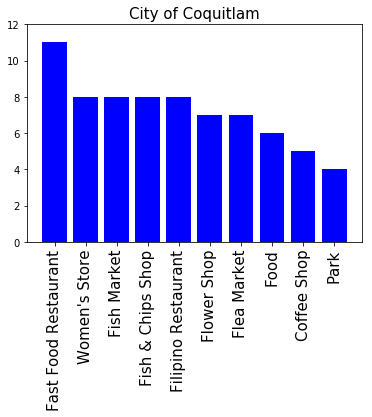

In [52]:
bar_venues(hood_venues_merged, 'Coquitlam')

## K-Means Algorithm

In [53]:
from sklearn.cluster import KMeans

from sklearn.metrics import silhouette_score
from sklearn.metrics import mean_squared_error as mse

In [55]:
BC_grouped_clustering = BC_grouped.drop('Neighborhood', 1)
BC_grouped_clustering.head()

,Yoga Studio,ATM,Accessories Store,African Restaurant,Airport,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,Antique Shop,...,Video Game Store,Video Store,Vietnamese Restaurant,Warehouse Store,Water Park,Waterfront,Whisky Bar,Wine Bar,Wine Shop,Women's Store
1,0.0,0.333333,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.027778,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


C:\Users\Krishant\Anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:882: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  f"KMeans is known to have a memory leak on Windows "


Text(0.5,1,'Elbow-Method')

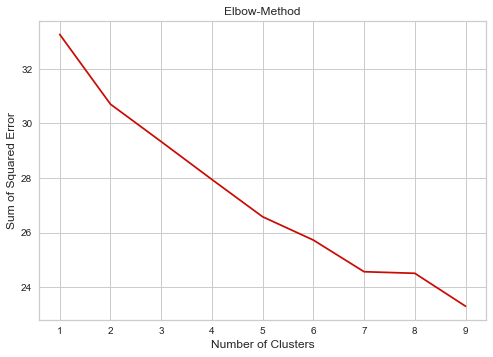

In [91]:
sse = []
for k in range(1,10):
    kmeans = KMeans(k, random_state = 0).fit(BC_grouped_clustering)
    sse.append(kmeans.inertia_)
plt.plot(range(1,10), sse, 'r-')
plt.xlabel('Number of Clusters', fontsize=12)
plt.ylabel('Sum of Squared Error', fontsize=12)
plt.title('Elbow-Method', fontsize=12)

C:\Users\Krishant\Anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:882: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  f"KMeans is known to have a memory leak on Windows "


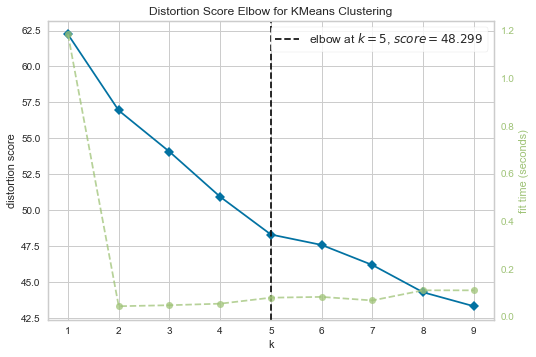

In [114]:
from yellowbrick.cluster import KElbowVisualizer
model = KMeans()
visualizer = KElbowVisualizer(model, k=(1,10))

visualizer.fit(BC_grouped_clustering)        # Fit the data to the visualizer
visualizer.show() 
#kelbow_visualizer(KMeans(random_state=1), BC_grouped_clustering, k=(2,10))

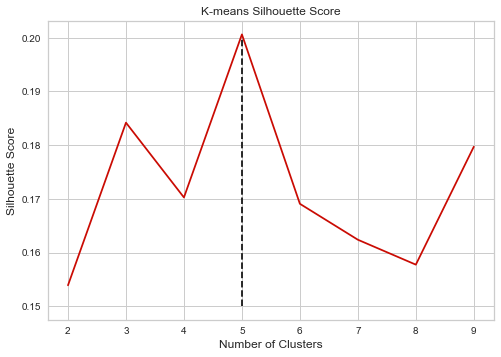

In [136]:
sil = []
for k in range(2,10):
    kmeans = KMeans(k, random_state = 0).fit(BC_grouped_clustering)
    labels = kmeans.labels_
    sil.append(silhouette_score(BC_grouped_clustering, labels, metric = 'euclidean'))
plt.plot(range(2,10), sil, 'r')
plt.xlabel('Number of Clusters', fontsize=12)
plt.ylabel('Silhouette Score', fontsize=12)
plt.title('K-means Silhouette Score', fontsize=12)
plt.vlines(5, 0.15, 0.2, linestyle="dashed")

#### Fit K-Means model with parameters chosen from analysis above

In [86]:
kclusters = 5
kmeans = KMeans(kclusters, random_state = 0).fit(BC_grouped_clustering)
labels = kmeans.labels_

In [89]:
# add clustering labels
neighborhoods_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)
van_df = van_df[van_df['Neighborhood'] != 'Abbotsford East']
BC_merged = van_df

# merge toronto_grouped with toronto_data to add latitude/longitude for each neighborhood
BC_merged = BC_merged.join(
    neighborhoods_venues_sorted.set_index('Neighborhood'), on='Neighborhood')

BC_merged.head() 

,Area,Neighborhood,Area Average Price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Burnaby,Brentwood Park,1526503.0,49.275226,-122.992929,2.0,Child Care Service,Café,Park,Bus Stop,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop
1,Coquitlam,Coquitlam West,1206271.0,49.262685,-122.816971,3.0,Bus Stop,Women's Store,Food,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Food & Drink Shop
2,Burnaby,Metrotown,1526503.0,49.225852,-123.003894,0.0,Bakery,Fast Food Restaurant,Electronics Store,Coffee Shop,Toy / Game Store,Bookstore,Sporting Goods Shop,Furniture / Home Store,Dessert Shop,Hotel
3,Vancouver East,Mount Pleasant VE,1455124.0,49.264048,-123.096249,0.0,Coffee Shop,Diner,Brewery,Sushi Restaurant,Breakfast Spot,Café,Vietnamese Restaurant,Food Truck,Thrift / Vintage Store,Bakery
4,North Surrey,Whalley,983842.0,49.196964,-122.864473,0.0,Electronics Store,Women's Store,Food,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Food & Drink Shop


In [124]:
BC_merged.shape

(271, 16)

In [125]:
BC_merged.dropna(axis=0,inplace=True)
BC_merged = BC_merged.reset_index(drop=True)
print(BC_merged.shape)
BC_merged.head()

(241, 16)


,Area,Neighborhood,Area Average Price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Burnaby,Brentwood Park,1526503.0,49.275226,-122.992929,2.0,Child Care Service,Café,Park,Bus Stop,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop
1,Coquitlam,Coquitlam West,1206271.0,49.262685,-122.816971,2.0,Bus Stop,Women's Store,Food,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Food & Drink Shop
2,Burnaby,Metrotown,1526503.0,49.225852,-123.003894,1.0,Bakery,Fast Food Restaurant,Electronics Store,Coffee Shop,Toy / Game Store,Bookstore,Sporting Goods Shop,Furniture / Home Store,Dessert Shop,Hotel
3,Vancouver East,Mount Pleasant VE,1455124.0,49.264048,-123.096249,1.0,Coffee Shop,Diner,Brewery,Sushi Restaurant,Breakfast Spot,Café,Vietnamese Restaurant,Food Truck,Thrift / Vintage Store,Bakery
4,North Surrey,Whalley,983842.0,49.196964,-122.864473,1.0,Electronics Store,Women's Store,Food,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Food & Drink Shop


In [92]:
BC_merged['Cluster Labels'].value_counts()

0.0    172
2.0     37
3.0     15
1.0     13
4.0      4
Name: Cluster Labels, dtype: int64

In [93]:
import matplotlib.cm as cm
import matplotlib.colors as colors

#### Try to label clusters based on most common venues within each cluster

In [127]:
## Function to create bar chart of top 10 venues of a city
clusters={}
clusters_freq={}
for i in range(kclusters):
    venues=[]
    for j in range(0, BC_merged.shape[0]):
        if BC_merged.loc[j, 'Cluster Labels'] == i:
            venues.append(BC_merged.iloc[j, 6])

    #venues_list = []
    #for sublist in venues:
        #for item in sublist:
            #venues_list.append(item)

    x = list(Counter(venues).keys()) # equals to list(set(words))
    y = list(Counter(venues).values()) # counts the elements' frequency

    sorted_x = [i for _, i in sorted(zip(y,x), reverse=True)]
    sorted_y = sorted(y, reverse=True)
    clusters['Cluster '+str(i)] = sorted_x[:4]
    clusters_freq['Cluster '+str(i)] = sorted_y[:4]

In [128]:
print(clusters)
print(clusters_freq)

{'Cluster 0': ['Park', 'Theater', 'Playground', 'Tennis Court'], 'Cluster 1': ['Coffee Shop', 'Chinese Restaurant', 'Pizza Place', 'Bank'], 'Cluster 2': ['Bus Stop', 'Park', 'Convenience Store', 'Department Store'], 'Cluster 3': ['Park', 'Construction & Landscaping', 'River', 'Soccer Field'], 'Cluster 4': ['Gym / Fitness Center', 'Baseball Field', 'Playground', 'Nail Salon']}
{'Cluster 0': [14, 4, 3, 2], 'Cluster 1': [31, 8, 6, 6], 'Cluster 2': [8, 5, 3, 1], 'Cluster 3': [4, 3, 2, 1], 'Cluster 4': [2, 2, 1, 1]}


In [98]:
#clusters['Cluster 3'] = ' Park'
clusters['Cluster 0'] = ['Bus Stop', ' Park', 'Convenience Store', 'Recreation Center']

In [102]:
rainbow = ['cyan', 'blue', 'red', 'green', 'black'] # set color scheme for clusters

Text(0,0.5,'Frequency')

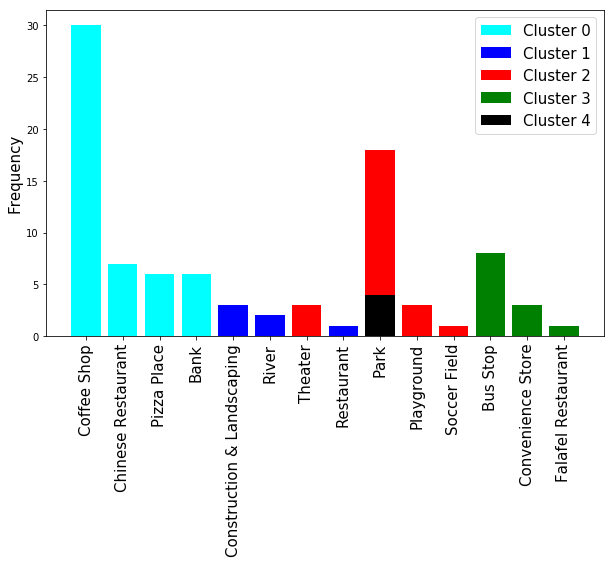

In [103]:
figure = plt.figure(figsize=(10,6))
plt.bar(clusters['Cluster 0'], clusters_freq['Cluster 0'],color=rainbow[0])
plt.bar(clusters['Cluster 1'], clusters_freq['Cluster 1'],color=rainbow[1])
plt.bar(clusters['Cluster 2'], clusters_freq['Cluster 2'],color=rainbow[2])
plt.bar(clusters['Cluster 3'], clusters_freq['Cluster 3'],color=rainbow[3])
plt.bar(clusters['Cluster 4'], clusters_freq['Cluster 4'],color=rainbow[4])
#plt.bar(clusters['Cluster 5'], clusters_freq['Cluster 5'],color='blue')
plt.xticks(rotation='vertical',fontsize=15)
plt.legend(['Cluster 0', 'Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4', 'Cluster 5'], fontsize=15)
plt.ylabel('Frequency',fontsize=15)

#### Final map that includes all the clusters superimposed on the average housing price of each area map

In [126]:
# create map
latitude, longtiude = 49.2057, -122.9110
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=10)

# set color scheme for the clusters
#x = np.arange(kclusters)
#ys = [i + x + (i*x)**2 for i in range(kclusters)]
#colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
#rainbow = [colors.rgb2hex(i) for i in colors_array]
#rainbow = ['#0000FF', '#15B01A', '#FF0000', '#FFD700', '#800080', '#000000'] # Colors according to bar plot
rainbow = ['cyan', 'blue', 'red', 'green', 'black']
# Create choropleth map as done previously
map_clusters.choropleth(
    geo_data=can_geo,
    data=van_df,
    columns=['Area', 'Area Average Price'],
    key_on='feature.properties.ADMIN_AREA_ABBREVIATION',
    threshold_scale=threshold_scale,
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Average Housing Price',
    reset=True
)
map_clusters

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(
    BC_merged['Latitude'], BC_merged['Longitude'], 
    BC_merged['Neighborhood'], BC_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[int(cluster)],
        fill=True,
        fill_color=rainbow[int(cluster)],
        fill_opacity=0.7).add_to(map_clusters)
map_clusters.save(outfile= "final_map.html")
map_clusters

#### Further explore clusters

In [80]:
BC_merged.head()

,Area,Neighborhood,Area Average Price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Burnaby,Brentwood Park,1526503.0,49.275226,-122.992929,4.0,Child Care Service,Café,Park,Bus Stop,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop
1,Coquitlam,Coquitlam West,1206271.0,49.262685,-122.816971,1.0,Bus Stop,Women's Store,Food,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Food & Drink Shop
2,Burnaby,Metrotown,1526503.0,49.225852,-123.003894,0.0,Bakery,Fast Food Restaurant,Electronics Store,Coffee Shop,Toy / Game Store,Bookstore,Sporting Goods Shop,Furniture / Home Store,Dessert Shop,Hotel
3,Vancouver East,Mount Pleasant VE,1455124.0,49.264048,-123.096249,0.0,Coffee Shop,Diner,Brewery,Sushi Restaurant,Breakfast Spot,Café,Vietnamese Restaurant,Food Truck,Thrift / Vintage Store,Bakery
4,North Surrey,Whalley,983842.0,49.196964,-122.864473,0.0,Electronics Store,Women's Store,Food,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Food & Drink Shop


In [81]:
print(len(BC_merged.loc[BC_merged['Cluster Labels'] == 0, BC_merged.columns[[1]+ 
            list(range(5, BC_merged.shape[1]))]]))
BC_merged.loc[BC_merged['Cluster Labels'] == 0, BC_merged.columns[[1]+ 
            list(range(5, BC_merged.shape[1]))]]

174


,Neighborhood,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
2,Metrotown,0.0,Bakery,Fast Food Restaurant,Electronics Store,Coffee Shop,Toy / Game Store,Bookstore,Sporting Goods Shop,Furniture / Home Store,Dessert Shop,Hotel
3,Mount Pleasant VE,0.0,Coffee Shop,Diner,Brewery,Sushi Restaurant,Breakfast Spot,Café,Vietnamese Restaurant,Food Truck,Thrift / Vintage Store,Bakery
4,Whalley,0.0,Electronics Store,Women's Store,Food,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Food & Drink Shop
8,Fort Langley,0.0,Restaurant,Burrito Place,Bakery,Coffee Shop,Bistro,Candy Store,Bookstore,Antique Shop,Market,Café
9,Burnaby Hospital,0.0,Gym / Fitness Center,Gym,Factory,Bus Stop,Coffee Shop,Café,American Restaurant,Latin American Restaurant,Women's Store,Flower Shop
...,...,...,...,...,...,...,...,...,...,...,...,...
236,Westham Island,0.0,Bank,Liquor Store,Grocery Store,Coffee Shop,Sandwich Place,Pub,Diner,Sushi Restaurant,Bookstore,Burger Joint
237,Sea Island,0.0,Coffee Shop,Airport Service,Rental Car Location,Airport Lounge,Fried Chicken Joint,Travel Lounge,Fish & Chips Shop,Sandwich Place,Pizza Place,Public Art
238,False Creek,0.0,Bar,Hockey Arena,Circus,Gastropub,Trail,Liquor Store,Science Museum,Scenic Lookout,Taco Place,Tapas Restaurant
239,North Coquitlam,0.0,Bus Stop,Coffee Shop,Vietnamese Restaurant,Yoga Studio,Electronics Store,Burger Joint,Bus Station,Shoe Store,Restaurant,Pub


In [82]:
print(len(BC_merged.loc[BC_merged['Cluster Labels'] == 1, BC_merged.columns[[1]+ 
            list(range(5, BC_merged.shape[1]))]]))
BC_merged.loc[BC_merged['Cluster Labels'] == 1, BC_merged.columns[[1]+ 
            list(range(5, BC_merged.shape[1]))]]

8


,Neighborhood,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
1,Coquitlam West,1.0,Bus Stop,Women's Store,Food,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Food & Drink Shop
10,Harbour Chines,1.0,Convenience Store,Bus Stop,Women's Store,Food,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop
67,Connaught Heights,1.0,Bus Stop,Light Rail Station,Bus Station,Convenience Store,Vietnamese Restaurant,Sandwich Place,Women's Store,Flower Shop,Fast Food Restaurant,Filipino Restaurant
93,Coquitlam East,1.0,Bus Stop,Women's Store,Food,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Food & Drink Shop
113,The Heights NW,1.0,Bus Stop,Light Rail Station,Bus Station,Convenience Store,Vietnamese Restaurant,Sandwich Place,Women's Store,Flower Shop,Fast Food Restaurant,Filipino Restaurant
144,Canyon Springs,1.0,Bus Stop,Women's Store,Food,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Food & Drink Shop
154,Harbour Place,1.0,Convenience Store,Bus Stop,Women's Store,Food,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop
171,McNair,1.0,Convenience Store,Bus Stop,Playground,Women's Store,Food,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market


In [83]:
print(len(BC_merged.loc[BC_merged['Cluster Labels'] == 2, BC_merged.columns[[1]+ 
            list(range(5, BC_merged.shape[1]))]]))
BC_merged.loc[BC_merged['Cluster Labels'] == 2, BC_merged.columns[[1]+ 
            list(range(5, BC_merged.shape[1]))]]

4


,Neighborhood,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
41,Matsqui,2.0,Breakfast Spot,Home Service,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Food,Food & Drink Shop
120,Montecito,2.0,Home Service,Baseball Field,Women's Store,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Food
123,Silver Valley,2.0,Home Service,Electronics Store,Women's Store,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Food
145,Heritage Mountain,2.0,Home Service,Women's Store,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Food


In [84]:
print(len(BC_merged.loc[BC_merged['Cluster Labels'] == 3, BC_merged.columns[[1]+ 
            list(range(5, BC_merged.shape[1]))]]))
BC_merged.loc[BC_merged['Cluster Labels'] == 3, BC_merged.columns[[1]+ 
            list(range(5, BC_merged.shape[1]))]]

19


,Neighborhood,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
16,Otter District,3.0,Department Store,Golf Course,Convenience Store,Construction & Landscaping,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market
23,Northlands,3.0,Restaurant,Construction & Landscaping,Golf Course,Women's Store,Flower Shop,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market
31,Ladner Elementary,3.0,Construction & Landscaping,Women's Store,Food,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop
40,Brookswood Langley,3.0,Clothing Store,Construction & Landscaping,Women's Store,Food,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop
59,East Newton,3.0,Park,Construction & Landscaping,Women's Store,Flower Shop,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market
73,Annieville,3.0,Gym,Park,Construction & Landscaping,Women's Store,Flower Shop,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market
106,Pemberton Heights,3.0,Playground,Convenience Store,Construction & Landscaping,Women's Store,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market
128,Burnaby Lake,3.0,Park,Trail,Construction & Landscaping,Harbor / Marina,Lake,Women's Store,Fish Market,Falafel Restaurant,Farmers Market,Fast Food Restaurant
130,Crescent Bch Ocean Pk.,3.0,Beach,Construction & Landscaping,Scenic Lookout,Women's Store,Flea Market,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market
137,Grandview Surrey,3.0,Gym Pool,Massage Studio,Grocery Store,Construction & Landscaping,Flea Market,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market


In [85]:
print(len(BC_merged.loc[BC_merged['Cluster Labels'] == 4, BC_merged.columns[[1]+ 
            list(range(5, BC_merged.shape[1]))]]))
BC_merged.loc[BC_merged['Cluster Labels'] == 4, BC_merged.columns[[1]+ 
            list(range(5, BC_merged.shape[1]))]]

36


,Neighborhood,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Brentwood Park,4.0,Child Care Service,Café,Park,Bus Stop,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop
5,Edmonds BE,4.0,Park,Bus Station,Gym / Fitness Center,Coffee Shop,Playground,Café,Food Court,Food & Drink Shop,Food Truck,Food
6,Whytecliff,4.0,Harbor / Marina,Park,Beach,Flea Market,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Women's Store
7,West Bay,4.0,Park,Beach,River,Women's Store,Flower Shop,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market
19,Clayton,4.0,Park,Convenience Store,Candy Store,Pizza Place,Sandwich Place,Food Court,Food Truck,Food & Drink Shop,Food,Flower Shop
21,Upper Caulfeild,4.0,Park,Bus Stop,Women's Store,Flower Shop,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Food
24,Upper Eagle Ridge,4.0,Bus Stop,Park,Gym / Fitness Center,Middle School,Women's Store,Flower Shop,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market
29,West Cambie,4.0,Art Gallery,Park,Basketball Court,Cosmetics Shop,Women's Store,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop
35,Kerrisdale,4.0,Park,Pool,Café,Golf Course,Flower Shop,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market
38,Saunders,4.0,Park,Gym,Tennis Court,Massage Studio,Flea Market,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Women's Store
